# Time Domain Science Cases in the Galactic Plane

The purpose of this notebook is to evaluate the science cases that require time domain observations.  Here I distinguish these cases from those requesting proper motion measurements, since they tend to be distinct in their observational requirements.  For the purposes of this analysis, time domain science is identifed as those cases which requested more than 3 visits per field pointing over the lifetime of the survey.  

In [1]:
import config_utils
import survey_footprints
import regions
import healpy as hp
from mw_plot import MWSkyMap, MWSkyMapBokeh
from astropy_healpix import HEALPix
from astropy import units as u
from astropy.coordinates import Galactic, TETE, SkyCoord
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import json
from os import path
%matplotlib inline


# Configure path to local repository
root_dir = '/Users/rstreet/software/rgps'

The requirements of all science cases proposed as White Papers and Science Pitches are described in the configuration file for this package:

In [12]:
config = config_utils.read_config(path.join(root_dir, 'config', 'rgps_survey_regions.json'))

Science cases requesting time domain observations are identifed in the configurations with a Boolean 'time_domain' key.  
So we can extract the information for just those cases for further analysis. 

In [16]:
time_domain_science = {author: info for author, info in config.items() if info['time_domain']}
print('Number of time domain science cases = ' + str(len(time_domain_science)))

Number of time domain science cases = 12


In [18]:
optical_components = ['F087', 'F106', 'F129', 'F158', 'F184', 'F213', 'F146', 'G150', 'P127']
requested_regions = {optic: [] for optic in optical_components}

for author in time_domain_science.keys():
    info = config[author]
    if info['ready_for_use']:
        for optic in optical_components:
            if optic in info.keys():
                for region in info[optic]:
                    region['label'] = author
                    region['optic'] = optic
                    requested_regions[optic].append(region)

requested_regions

{'F087': [{'l': [-95.0, 103.0],
   'b': [-13.0, 9.0],
   'label': 'Bahramian',
   'optic': 'F087'},
  {'l': [-115.0, 130.0],
   'b': [-3.0, 3.0],
   'label': 'Bahramian',
   'optic': 'F087'}],
 'F106': [{'l': [-10.0, 10.0],
   'b': [-1.0, 1.0],
   'label': 'Navarro',
   'optic': 'F106'}],
 'F129': [{'l': [-10.0, 10.0],
   'b': [-1.0, 1.0],
   'label': 'Navarro',
   'optic': 'F129'},
  {'pointing': [28.5, 0.0, 0.3], 'label': 'Morihana1', 'optic': 'F129'},
  {'l': [20.0, 50.0], 'b': [-3.0, 3.0], 'label': 'Morihana1', 'optic': 'F129'},
  {'l': [-95.0, 103.0],
   'b': [-13.0, 9.0],
   'label': 'Bahramian',
   'optic': 'F129'},
  {'l': [-115.0, 130.0],
   'b': [-3.0, 3.0],
   'label': 'Bahramian',
   'optic': 'F129'}],
 'F158': [{'l': [-1, 1.0],
   'b': [-3.0, 3.0],
   'label': 'Freeman',
   'optic': 'F158'},
  {'l': [89.0, 91.0], 'b': [-3.0, 3.0], 'label': 'Freeman', 'optic': 'F158'},
  {'l': [179.0, 181.0], 'b': [-3.0, 3.0], 'label': 'Freeman', 'optic': 'F158'},
  {'l': [269.0, 271.0], 'b

## Sky Regions for Time Domain Surveys

It's informative to examine what regions of sky have been requested for time-domain surveys. 

In order to do this, we first convert each sky region into a HEALpixel map

In [19]:
desired_regions = {}

for optic, region_list in requested_regions.items():
    regions_for_optic = []
    for box in region_list:
        if 'catalog' in box.keys():
            region_set = regions.create_region_set(box)
        else:
            region_set = [ regions.create_region(box) ]

        for r in region_set:
            # If the region is valid, the list of included pixels will be non-zero. 
            # Each pixel within a region is given a value of 1 - essentially being a 'vote' for that pixel, 
            # for each science case.
            if len(r.pixels) > 0:
                r.pixel_priority = np.zeros(r.NPIX)
                r.pixel_priority[r.pixels] = 1.0
                r.predefined_pixels = True
                r.make_map()
                
                regions_for_optic.append(r)
        
    desired_regions[optic] = regions_for_optic

for optic, regions_for_optic in desired_regions.items():
    if len(regions_for_optic) > 0:
        print(optic + ' has region(s):')
        for r in regions_for_optic:
            print(r.summary())
    else:
        print(optic + ' has no requested regions')

F087 has region(s):
Bahramian: l_center=4.0 deg, b_center=-2.0 deg n_pixels=16286 F087
Bahramian: l_center=7.5 deg, b_center=0.0 deg n_pixels=5500 F087
F106 has region(s):
Navarro: l_center=0.0 deg, b_center=0.0 deg n_pixels=154 F106
F129 has region(s):
Navarro: l_center=0.0 deg, b_center=0.0 deg n_pixels=154 F129
Morihana1: l_center=28.5, b_center=0.0 n_pixels=3 F129
Morihana1: l_center=35.0 deg, b_center=0.0 deg n_pixels=669 F129
Bahramian: l_center=4.0 deg, b_center=-2.0 deg n_pixels=16286 F129
Bahramian: l_center=7.5 deg, b_center=0.0 deg n_pixels=5500 F129
F158 has region(s):
Freeman: l_center=0.0 deg, b_center=0.0 deg n_pixels=46 F158
Freeman: l_center=90.0 deg, b_center=0.0 deg n_pixels=44 F158
Freeman: l_center=180.0 deg, b_center=0.0 deg n_pixels=45 F158
Freeman: l_center=270.0 deg, b_center=0.0 deg n_pixels=46 F158
Navarro: l_center=0.0 deg, b_center=0.0 deg n_pixels=154 F158
Morihana1: l_center=28.5, b_center=0.0 n_pixels=3 F158
Morihana1: l_center=35.0 deg, b_center=0.0 deg

Based on this collection of regions per optic, we can produce a combined map.

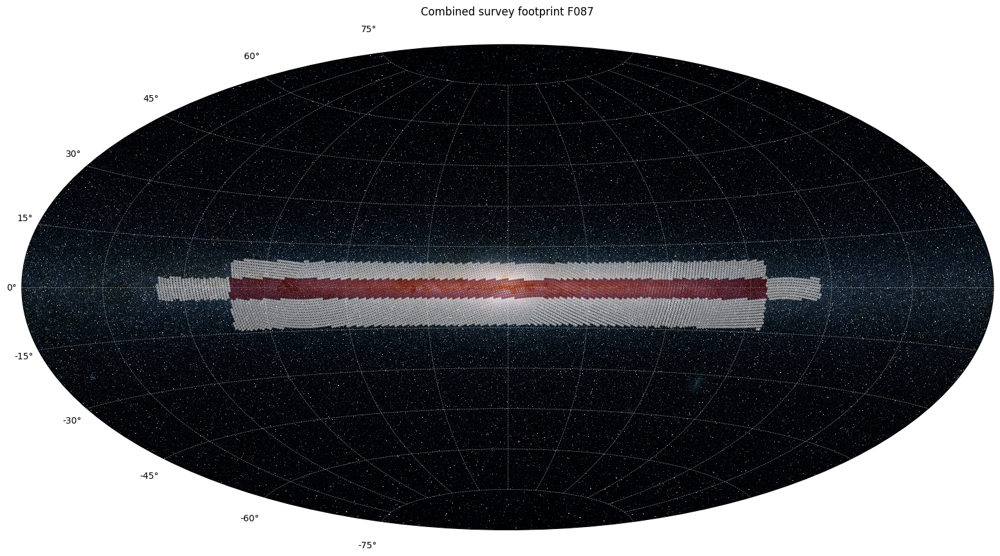

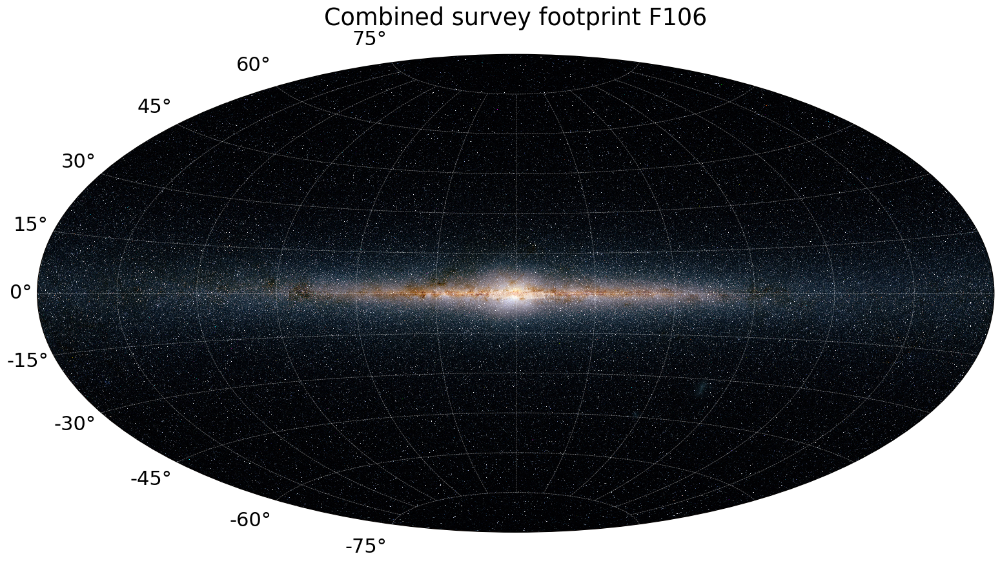

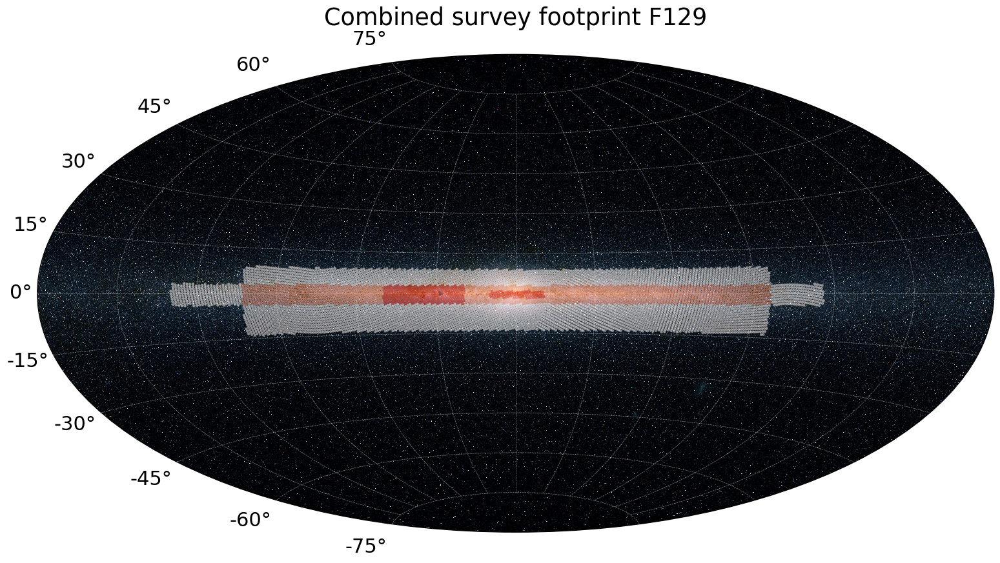

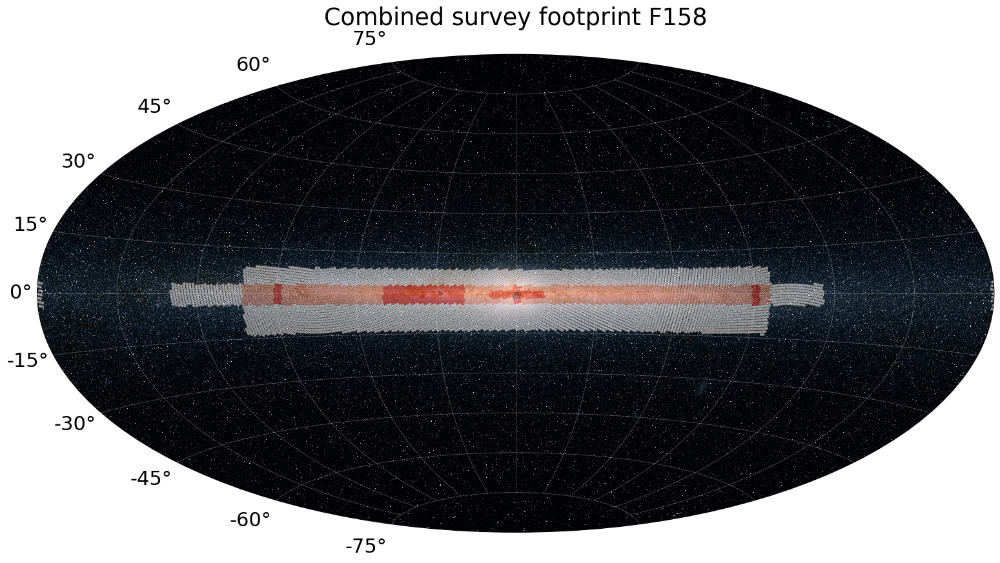

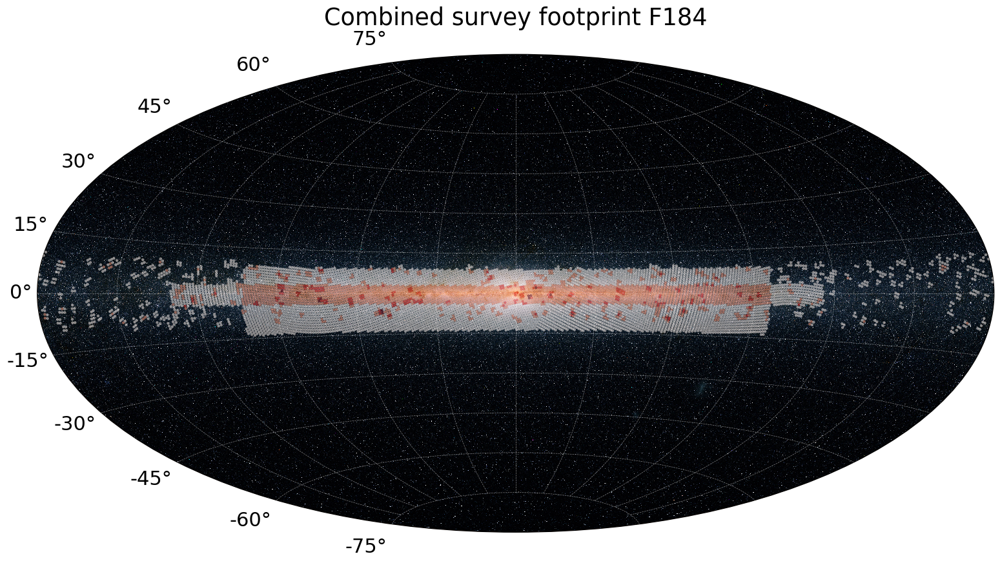

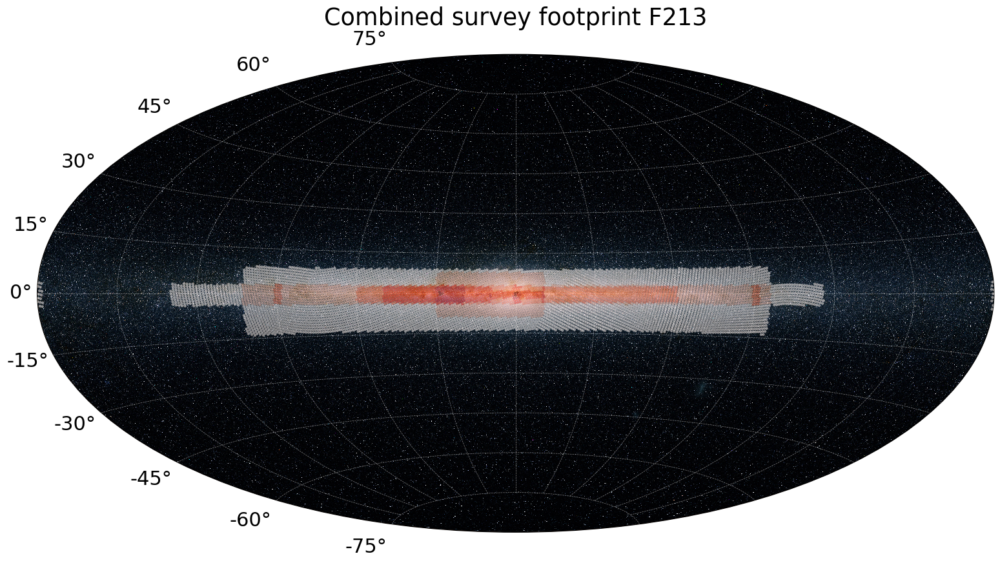

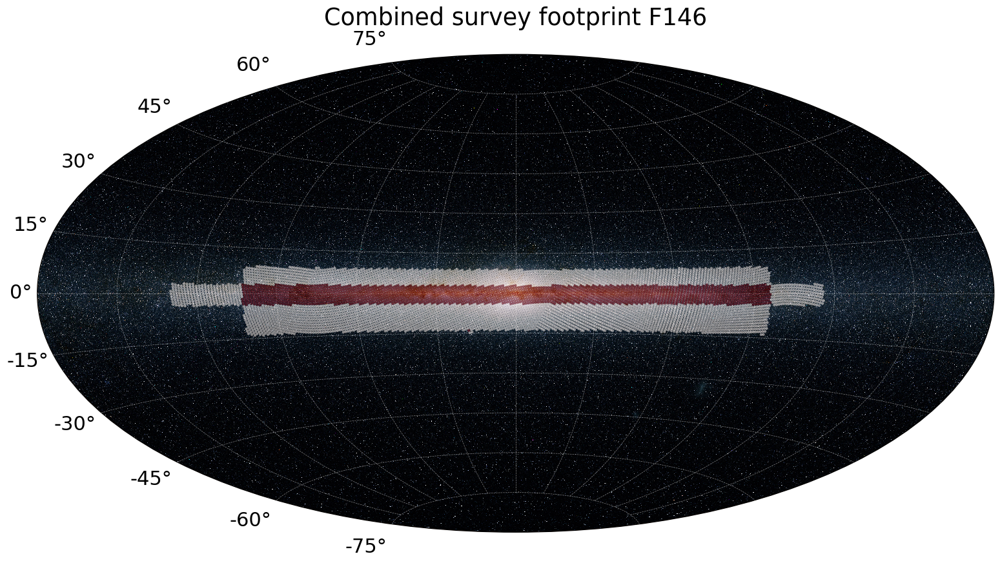

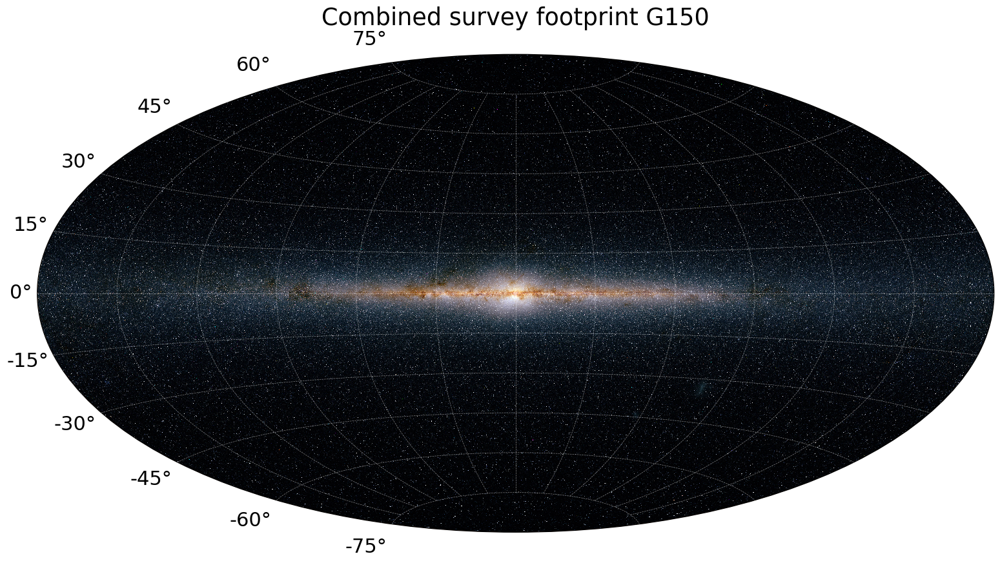

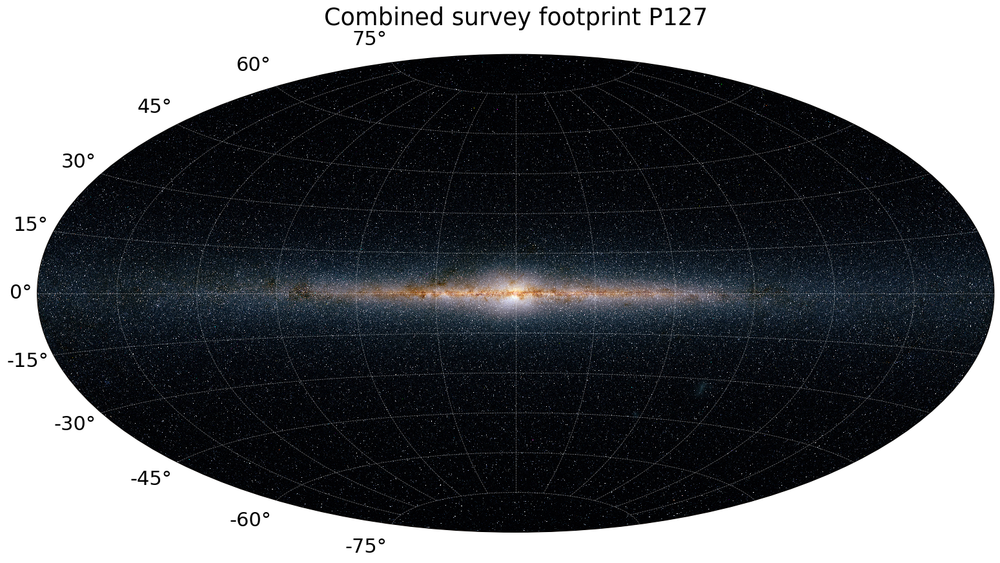

In [20]:
# Dictionary of the combined survey regions per optical component
combined_regions = {}

for optic, region_list in desired_regions.items():
    if len(region_list) > 0:
        r_merge = regions.combine_regions(region_list)
        r_merge.optic = optic
        r_merge.label = 'Combined survey footprint'

        mw1 = MWSkyMap(projection='aitoff', grayscale=False, grid='galactic', background='infrared', figsize=(16, 10))
        mw1.title = r_merge.label + ' ' + r_merge.optic
        s = r_merge.pixels_to_skycoords()
        mw1.scatter(s.ra.deg * u.deg, s.dec.deg * u.deg, c=r_merge.region_map[r_merge.pixels], cmap='Reds', s=5, alpha=0.4)
        plt.rcParams.update({'font.size': 22})

        plt.tight_layout()
        plt.savefig(path.join(root_dir, 'time_domain_science', 'survey_map_'+r_merge.optic+'.png'))
                    
        combined_regions[optic] = r_merge

As the heatmaps above illustrate, the requested sky regions overlap in many cases, indicating that multiple science goals can be served by observations of those regions in that filter.  Since there is an obvious tension between the total area surveyed and the achievable cadence, it is helpful to explore the total area as a function of the number of science cases

## Optical Components Requested and Survey Area

We can also explore what filters have been requested specifically for time-domain surveys, and what total area of sky would be needed in each case.



In [ ]:
for optic, r_merge in combined_regions.items():
    